### Generic Imports

In [2]:
#import scipy.signal
import time
from torch.optim.lr_scheduler import StepLR
import torch.optim as optim
import torch.nn as nn
import openunmix
import use_openunmix
from use_openunmix import SlakhDataset
import pickle
import os
import torch
import musdb
import norbert
import sklearn.preprocessing
import random
import warnings
import matplotlib.pyplot as plt
import tqdm
import numpy as np
from IPython.display import Audio, display
print('Start')
#from matplotlib import gridspec

warnings.simplefilter(action='ignore', category=FutureWarning)

%load_ext autoreload
%autoreload 2


Start


ModuleNotFoundError: No module named 'use_openunmix'

Initialize the dataset

In [ ]:
if os.path.abspath(os.getcwd()) == '/home/olaf/Documents/GitHub/ddspzart/workspace_2/open-unmix-pytorch':
    %cd ../source_separation/
%pwd

TARGET = "Flute"
train_dataset = SlakhDataset(target=TARGET, seq_duration=5.0)
validation_dataset = SlakhDataset(
    target=TARGET, split='validation', seq_duration=5.0)


In [ ]:
train_dataset.tracks[:7]


[Track 5, Track 6, Track 7, Track 13, Track 16, Track 19, Track 41]

In [ ]:
# Checking dataset

# print(train_dataset.all_tracks[0].targets)
i = 3
print([train_dataset.tracks[i].targets[j].instrument for j in range(len(train_dataset.tracks[i].targets))])
audios = [train_dataset.tracks[i].targets[j].get_total_audio() for j in [3,4,8,-1]]

# for i = 0: Trumpet, Electric Guitar (clean), Alto Sax, Flute

# Trumpet, Flute, Alto Sax, Electric Guitar
# -> Flute, Violin, Guitar, French Horn

# x = train_dataset.tracks[i].targets[0].get_total_audio()
# display(Audio(x, rate=44100))

['Lead 3 (calliope)', 'Trumpet', 'Lead 3 (calliope)', 'Bright Acoustic Piano', 'Alto Sax', 'Tenor Sax', 'String Ensemble 1', 'Trumpet', 'Brass Section', 'Electric Guitar (jazz)', 'String Ensemble 1', 'Drums']


In [ ]:
train_dataset

In [ ]:
for audio_ in audios:
    plt.figure()
    plt.plot(audio_)

In [ ]:
for audio_ in audios:
    display(Audio(audio_, rate=44100))
display(Audio(np.sum(np.array(audios), axis=0), rate=44100))


0.27954102

In [ ]:
# train_dataset.target = "Trumpet"
# train_dataset.filter_target()

train_sampler = torch.utils.data.DataLoader(
    train_dataset, batch_size=8, shuffle=True)
print("Number of audio files:", len(train_dataset))
x = train_dataset.targets[5].get_total_audio()
display(Audio(x, rate=44100))


validation_sampler = torch.utils.data.DataLoader(
    validation_dataset, batch_size=8, shuffle=True)


Number of audio files: 169


In [ ]:
%cd ../open-unmix-pytorch/
%pwd

/home/olaf/Documents/GitHub/ddspzart/workspace_2/open-unmix-pytorch


'/home/olaf/Documents/GitHub/ddspzart/workspace_2/open-unmix-pytorch'

In [ ]:
# Example input for model
# -> shape (nb_samples, nb_channels, nb_bins, nb_frames, complex=2)
stft = openunmix.transforms.TorchSTFT()
# -> shape (nb_samples, nb_channels(=1 if mono), nb_bins, nb_frames)
spec = openunmix.transforms.ComplexNorm(mono=True)
transform = nn.Sequential(stft, spec)


torch.Size([1, 220500])
torch.Size([1, 1, 2049, 212])


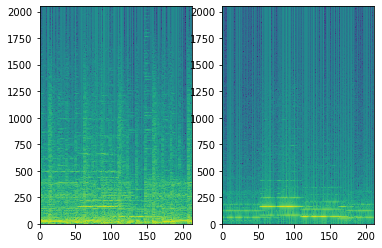

In [ ]:
x, y = train_dataset[0]
print(x.shape)

# transform the time domain input to spectrograms
X = transform(x[None])
Y = transform(y[None])
print(X.shape)

f, axes = plt.subplots(1, 2)
axes[0].pcolormesh(np.log(X[0, 0, :, :].detach().numpy()))
axes[1].pcolormesh(np.log(Y[0, 0, :, :].detach().numpy()))

display(Audio(x, rate=44100))
display(Audio(y, rate=44100))


## Compute global mean and scale of Dataset

Sample from the dataset and update mean standard deviation using scikit-learn `StandardScaler`.

  0%|          | 0/169 [00:00<?, ?it/s]

/home/olaf/Documents/GitHub/ddspzart/workspace_2/.openunmix_venv/lib/python3.7/site-packages/ipykernel_launcher.py:4: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matricesor `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2318.)
  after removing the cwd from sys.path.


torch.Size([212, 2049, 1, 1]) torch.Size([1, 1, 2049, 212])


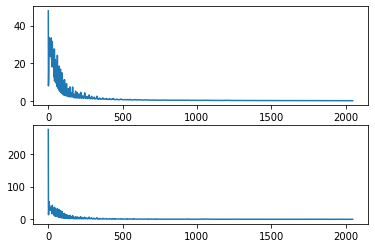

In [ ]:
scaler = sklearn.preprocessing.StandardScaler()

for x, y in tqdm.notebook.tqdm(train_dataset):
    X = transform(x[None]).T
    scaler.partial_fit(X.squeeze().numpy())
print(X.shape, X.T.shape)

# set initial input scaler values
scale = np.maximum(
    scaler.scale_,
    1e-4*np.max(scaler.scale_)
)
mean = scaler.mean_

f, axes = plt.subplots(2, 1)
axes[0].plot(mean)
axes[1].plot(scale)


## Set up the model

In [ ]:
use_cuda = torch.cuda.is_available()
torch.manual_seed(42)

device = torch.device("cuda" if use_cuda else "cpu")
kwargs = {'num_workers': 1, 'pin_memory': True} if use_cuda else {}
device = "cpu"

unmix = openunmix.model.OpenUnmix(
    input_mean=mean,
    input_scale=scale,
    nb_channels=1,
    hidden_size=512,
    max_bin=512,
    nb_bins=2048+1
).to(device)

optimizer = optim.RMSprop(unmix.parameters(), lr=0.005)
criterion = torch.nn.MSELoss()
VALID_EVERY_N_EPOCH = 3

scheduler = StepLR(optimizer, step_size=30, gamma=0.8)


# Train a model 

In [ ]:
from torch.utils.tensorboard import SummaryWriter
writer = SummaryWriter(log_dir="../source_separation/runs/exp6_flute")
epoch = 0


In [ ]:
# Prepare sampling and transformation
train_sampler = torch.utils.data.DataLoader(
    train_dataset, batch_size=8, shuffle=True, num_workers=4)
validation_sampler = torch.utils.data.DataLoader(
    validation_dataset, batch_size=8, num_workers=4)
stft = openunmix.transforms.TorchSTFT()
spec = openunmix.transforms.ComplexNorm(mono=True)
transform = nn.Sequential(stft, spec).to(device)


In [ ]:
tic = time.perf_counter()
for i, (x, y) in tqdm.notebook.tqdm(enumerate(train_sampler)):
    x, y = x.to(device), y.to(device)
    X = transform(x)
    Y = transform(y)
    toc = time.perf_counter()
    optimizer.zero_grad()
    Y_hat = unmix(X)
    toc2 = time.perf_counter()
    print(toc-tic, toc2-toc)
    tic = time.perf_counter()
    if i > 3:
        break

# Per item: get sel 0.16764575699926354 0.0959930570006690 -> Loading takes the most time
# one worker: 1.5s / 0.4s
# four workers: <0.1s / 0.4s


0it [00:00, ?it/s]

18.46280019200276 15.737220471997716
0.05312831400078721 1.8129613400014932
0.06479057600154192 0.9680991579989495
0.1762099789993954 0.40518244299892103
0.08306511099726777 0.4524377910020121


In [ ]:
# Training
losses = openunmix.utils.AverageMeter()
losses_valid = openunmix.utils.AverageMeter()
unmix.train()
stft = openunmix.transforms.TorchSTFT()
spec = openunmix.transforms.ComplexNorm(mono=True)
transform = nn.Sequential(stft, spec).to(device)

keep_epoch = epoch

tic = time.perf_counter()
tic2 = time.process_time()

for epoch in tqdm.notebook.tqdm(range(keep_epoch, 100+keep_epoch)):
    for x, y in train_sampler:  # tqdm.notebook.tqdm(train_sampler):
        x, y = x.to(device), y.to(device)
        X = transform(x)
        Y = transform(y)
        optimizer.zero_grad()
        Y_hat = unmix(X)
        loss = torch.nn.functional.mse_loss(Y_hat, Y)
        loss.backward()
        optimizer.step()
        losses.update(loss.item(), Y.size(1))
    writer.add_scalar("Loss/train", losses.avg, epoch)
    print(f"Loss={losses.avg:.3f}", "LR: ", scheduler.get_last_lr())
    scheduler.step()
    keep_epoch = epoch + 1
    if epoch % VALID_EVERY_N_EPOCH == 0:
        unmix.eval()
        with torch.no_grad():
            val_loss = []
            for x, y in validation_sampler:
                x, y = x.to(device), y.to(device)
                X = transform(x)
                Y = transform(y)
                Y_hat = unmix(X)
                loss_valid = torch.nn.functional.mse_loss(Y_hat, Y)
                losses_valid.update(loss_valid.item(), Y.size(1))
            writer.add_scalar("Loss/validation", losses_valid.avg, epoch)
            print(f"validation: {losses_valid.avg:.3f}")
        unmix.train()

writer.flush()
writer.close()

toc = time.perf_counter()
toc2 = time.process_time()
print('Time elapsed:', toc - tic, toc2-tic2)


  0%|          | 0/100 [00:00<?, ?it/s]

Loss=68.161 LR:  [0.005]


Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f29b85f4830>
Traceback (most recent call last):
  File "/home/olaf/Documents/GitHub/ddspzart/workspace_2/.openunmix_venv/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1358, in __del__
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f29b85f4830>
Traceback (most recent call last):
  File "/home/olaf/Documents/GitHub/ddspzart/workspace_2/.openunmix_venv/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1358, in __del__
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f29b85f4830>
Traceback (most recent call last):
  File "/home/olaf/Documents/GitHub/ddspzart/workspace_2/.openunmix_venv/lib/python3.7/site-packages/torch/utils/data/dataloader.py", line 1358, in __del__
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x7f29b85f4830>
Traceback (most recent call last):
  File "/home/olaf/Documents/Git

validation: 49.222
Loss=38.092 LR:  [0.005]
Loss=27.324 LR:  [0.005]
Loss=21.591 LR:  [0.005]
validation: 26.352
Loss=18.053 LR:  [0.005]
Loss=15.599 LR:  [0.005]
Loss=13.837 LR:  [0.005]
validation: 18.452
Loss=12.512 LR:  [0.005]
Loss=11.468 LR:  [0.005]
Loss=10.600 LR:  [0.005]
validation: 14.572
Loss=9.875 LR:  [0.005]
Loss=9.245 LR:  [0.005]
Loss=8.743 LR:  [0.005]
validation: 12.191
Loss=8.291 LR:  [0.005]
Loss=7.887 LR:  [0.005]
Loss=7.519 LR:  [0.005]
validation: 10.514
Loss=7.195 LR:  [0.005]
Loss=6.914 LR:  [0.005]
Loss=7.413 LR:  [0.005]
validation: 10.680
Loss=7.177 LR:  [0.005]
Loss=6.940 LR:  [0.005]
Loss=6.729 LR:  [0.005]
validation: 9.639
Loss=6.529 LR:  [0.005]
Loss=6.359 LR:  [0.005]
Loss=6.181 LR:  [0.005]
validation: 8.870
Loss=6.017 LR:  [0.005]
Loss=5.868 LR:  [0.005]
Loss=5.739 LR:  [0.005]
validation: 8.263
Loss=7.922 LR:  [0.005]
Loss=7.726 LR:  [0.005]
Loss=7.539 LR:  [0.004]
validation: 7.628
Loss=7.367 LR:  [0.004]
Loss=7.203 LR:  [0.004]
Loss=7.051 LR:  [0

KeyboardInterrupt: 

In [ ]:
SAVE_PATH = f"../source_separation/data/checkpoints/"
CKPT_FILE = "exp6_flute.pt"
DATASET_STAT_FILE = "exp6_flute.pickle"
%pwd


'/home/olaf/Documents/GitHub/ddspzart/workspace_2/open-unmix-pytorch'

In [ ]:
# Save model
torch.save({
    'epoch': epoch,
    'model_state_dict': unmix.state_dict(),
    'optimizer_state_dict': optimizer.state_dict(),
    'loss': loss,
}, SAVE_PATH+CKPT_FILE)


In [ ]:
with open(SAVE_PATH+DATASET_STAT_FILE, 'wb') as pickle_file:
    pickle.dump([mean, scale], pickle_file)


In [ ]:
checkpoint = torch.load(SAVE_PATH+CKPT_FILE)
unmix.load_state_dict(checkpoint['model_state_dict'])
optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
epoch = checkpoint['epoch']
loss = checkpoint['loss']


In [ ]:
f, axes = plt.subplots(1, 3)
axes[0].pcolormesh(np.log(X[0, 0, :, :].detach().cpu().numpy()))
axes[1].pcolormesh(np.log(Y[0, 0, :, :].detach().cpu().numpy()))
axes[2].pcolormesh(np.log(Y_hat[0, 0, :, :].detach().cpu().numpy()))


In [ ]:
# separate with custom trained models
track = train_dataset[0]

print(track[0][None, ...].shape)
audio_torch = track[0][None, ...].float().to(device)
print(audio_torch)
target_models = {"French horn": unmix}
own_separator = openunmix.model.Separator(
    target_models, nb_channels=1).to(device)
#y = torch.tensor(track[1][None,...]).float().to(device).clone().detach().squeeze()
y = track[1][None, ...].float().to(device).squeeze()
print(y)
y_hat = own_separator.forward(audio_torch).clone().detach().squeeze()
print(y_hat)
display(Audio(track[0], rate=44100))
display(Audio(y.cpu().numpy(), rate=44100))
display(Audio(y_hat.cpu().numpy(), rate=44100))

print(torch.mean((y-y_hat)**2))


get item 0.2800896990002002
torch.Size([1, 1, 220500])
tensor([[[ 0.0320,  0.0334,  0.0362,  ..., -0.0493, -0.0417, -0.0359]]])
tensor([-0.0483, -0.0481, -0.0458,  ..., -0.0016, -0.0004,  0.0012])
tensor([ 0.0013,  0.0012,  0.0012,  ..., -0.0038,  0.0002,  0.0024])


tensor(0.0009)


In [ ]:
# Testing
test_dataset = SlakhDataset(split='test', seq_duration=5.0)
test_sampler = torch.utils.data.DataLoader(
    test_dataset, batch_size=8, shuffle=True)


  0%|          | 0/151 [00:00<?, ?it/s]

In [ ]:
test_dataset.target = 'Trumpet'
test_dataset.filter_target()

unmix.eval()
stft = openunmix.transforms.TorchSTFT()
spec = openunmix.transforms.ComplexNorm(mono=True)
transform = nn.Sequential(stft, spec).to(device)
losses = openunmix.utils.AverageMeter()


In [ ]:
for epoch in tqdm.notebook.tqdm(range(4)):
    for x, y in test_sampler:
        x, y = x.to(device), y.to(device)
        X = transform(x)
        Y = transform(y)
        Y_hat = unmix(X)
        loss = torch.nn.functional.mse_loss(Y_hat, Y)
        losses.update(loss.item(), Y.size(1))
    print(f"{losses.avg:.3f}")

  0%|          | 0/4 [00:00<?, ?it/s]

0.512
0.359
0.427
0.336


In [ ]:
# Evaluation
import museval

global_rate = 44_100
win = 1.0
hop = 1.0
mode = 'v4'
y_np = y.cpu().numpy()
y_hat_np = y_hat.cpu().numpy()
reference = np.reshape(y_np, (1, len(y), 1))
estimates = np.reshape(y_hat_np, (1, len(y), 1))

print(reference.shape, estimates.shape)

metrics = museval.evaluate(reference, estimates,
                           win=int(win*global_rate), hop=int(hop*global_rate), mode=mode)

metrics = [np.mean(m) for m in metrics]
print(metrics)
SDR, ISR, SIR, SAR = metrics


(1, 220500, 1) (1, 220500, 1)
[-0.30052876664668793, 2.9240673314491366, inf, -6.198049423589732]


## Synthesize



In [ ]:
import musdb
mus = musdb.DB(download=True, subsets='test')
track = mus[1]
print(track.audio.T[None, ...].shape)


(300032, 2)

In [ ]:
track = train_dataset[0]
print(track[0][None, ...].shape)


torch.Size([1, 1, 220500])
